In [22]:
import json
import logging
import random
import os
from datetime import datetime
from typing import List, Dict
import pandas as pd

import matplotlib.pyplot as plt
from wordcloud import WordCloud
from collections import Counter
from nltk.util import ngrams
import re


logging.basicConfig(level=logging.INFO)
logger = logging.getLogger(__name__)

print("All libraries imported successfully!")

All libraries imported successfully!


In [16]:
ASPECT_MAP = {
    "Địa điểm": 1,
    "Kịch bản": 2,
    "Dàn dựng": 3,
    "Dàn cast": 4,
    "Khách mời": 5,
    "Khả năng chơi trò chơi": 6,
    "Quảng cáo": 7,
    "Thử thách": 8,
    "Tương tác giữa các thành viên": 9,
    "Tinh thần đồng đội": 10,
    "Khác": 0
}

SENTIMENT_MAP = {
    "tích cực": 1,
    "tiêu cực": 2,
    "trung tính": 0,
}

In [5]:
with open('comments.json', 'r') as file:
    data = json.load(file)

data

{'results': [{'text': 'ai chơi trò chạy đi chờ chi với đội anh thành là thắng nhiều thua ít kk',
   'labels': [{'entity': 'đội anh thành',
     'aspect': 'Thử thách',
     'opinion': 'thành là thắng nhiều thua ít',
     'sentiment': 'tích cực'}]},
  {'text': 'mong mùa 2 dàn cast cũ 29 4 2020 cày lại',
   'labels': [{'entity': 'dàn cast cũ',
     'aspect': '4. Dàn cast',
     'opinion': 'mong',
     'sentiment': 'tích cực'}]},
  {'text': 'chờ đợi mùa haiiii mòn cả cổ',
   'labels': [{'entity': 'implicit',
     'aspect': 'Khác',
     'opinion': 'chờ đợi mùa haiiii mòn cả cổ',
     'sentiment': 'tích cực'}]},
  {'text': 'đây là lần thứ n em xem lại và em sẽ giả vờ là không biết có những ai tham gia cdcc',
   'labels': [{'entity': 'implicit',
     'aspect': 'Dàn cast',
     'opinion': 'giả vờ là không biết có những ai tham gia cdcc',
     'sentiment': 'trung tính'}]},
  {'text': 'xem xong chạy đi chờ chi tự dựng lại ghét ghét trấn thành',
   'labels': [{'entity': 'Trấn Thành',
     'aspect

In [6]:
print(json.dumps(data, indent=4, ensure_ascii=False))

{
    "results": [
        {
            "text": "ai chơi trò chạy đi chờ chi với đội anh thành là thắng nhiều thua ít kk",
            "labels": [
                {
                    "entity": "đội anh thành",
                    "aspect": "Thử thách",
                    "opinion": "thành là thắng nhiều thua ít",
                    "sentiment": "tích cực"
                }
            ]
        },
        {
            "text": "mong mùa 2 dàn cast cũ 29 4 2020 cày lại",
            "labels": [
                {
                    "entity": "dàn cast cũ",
                    "aspect": "4. Dàn cast",
                    "opinion": "mong",
                    "sentiment": "tích cực"
                }
            ]
        },
        {
            "text": "chờ đợi mùa haiiii mòn cả cổ",
            "labels": [
                {
                    "entity": "implicit",
                    "aspect": "Khác",
                    "opinion": "chờ đợi mùa haiiii mòn cả cổ",
               

In [7]:
first_key = list(data.keys())[0]
items = data[first_key]

print(json.dumps(items[0], indent=4, ensure_ascii=False))

{
    "text": "ai chơi trò chạy đi chờ chi với đội anh thành là thắng nhiều thua ít kk",
    "labels": [
        {
            "entity": "đội anh thành",
            "aspect": "Thử thách",
            "opinion": "thành là thắng nhiều thua ít",
            "sentiment": "tích cực"
        }
    ]
}


In [12]:
rows = []

for item in items:
    text = item.get('text', '')
    labels = item.get('labels', [])

    if not labels: # Trường hợp text không có nhãn nào
        rows.append({
            'text': text,
            'entity': None,
            'aspect': None,
            'opinion': None,
            'sentiment': None
        })
    else:
        for label in labels:
            rows.append({
                'text': text,
                'entity': label.get('entity'),
                'aspect': label.get('aspect'),
                'opinion': label.get('opinion'),
                'sentiment': label.get('sentiment')
            })

df = pd.DataFrame(rows)

In [13]:
df.head()

,text,entity,aspect,opinion,sentiment
0,ai chơi trò chạy đi chờ chi với đội anh thành ...,đội anh thành,Thử thách,thành là thắng nhiều thua ít,tích cực
1,mong mùa 2 dàn cast cũ 29 4 2020 cày lại,dàn cast cũ,4. Dàn cast,mong,tích cực
2,chờ đợi mùa haiiii mòn cả cổ,implicit,Khác,chờ đợi mùa haiiii mòn cả cổ,tích cực
3,đây là lần thứ n em xem lại và em sẽ giả vờ là...,implicit,Dàn cast,giả vờ là không biết có những ai tham gia cdcc,trung tính
4,xem xong chạy đi chờ chi tự dựng lại ghét ghét...,Trấn Thành,Tương tác giữa các thành viên,ghét,tiêu cực


In [18]:
aspect_list = ASPECT_MAP.keys()
sentiment_list = SENTIMENT_MAP.keys()

df = df[df['aspect'].isin(aspect_list) & df['sentiment'].isin(sentiment_list)]

C:\Users\MSI GL65\AppData\Local\Temp\ipykernel_14180\4190624453.py:10: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, x='sentiment', palette='viridis')
C:\Users\MSI GL65\AppData\Local\Temp\ipykernel_14180\4190624453.py:16: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(data=df, y='aspect', order=top_aspects, palette='magma')


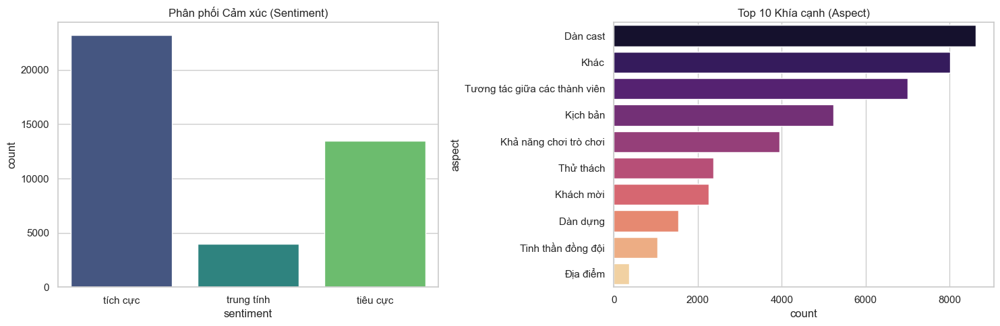

In [19]:
import matplotlib.pyplot as plt
import seaborn as sns

# Cấu hình giao diện
plt.figure(figsize=(15, 5))
sns.set_theme(style="whitegrid")

# Biểu đồ 1: Phân phối Sentiment
plt.subplot(1, 2, 1)
sns.countplot(data=df, x='sentiment', palette='viridis')
plt.title('Phân phối Cảm xúc (Sentiment)')

# Biểu đồ 2: Top 10 Aspect phổ biến nhất
plt.subplot(1, 2, 2)
top_aspects = df['aspect'].value_counts().nlargest(10).index
sns.countplot(data=df, y='aspect', order=top_aspects, palette='magma')
plt.title('Top 10 Khía cạnh (Aspect)')

plt.tight_layout()
plt.show()

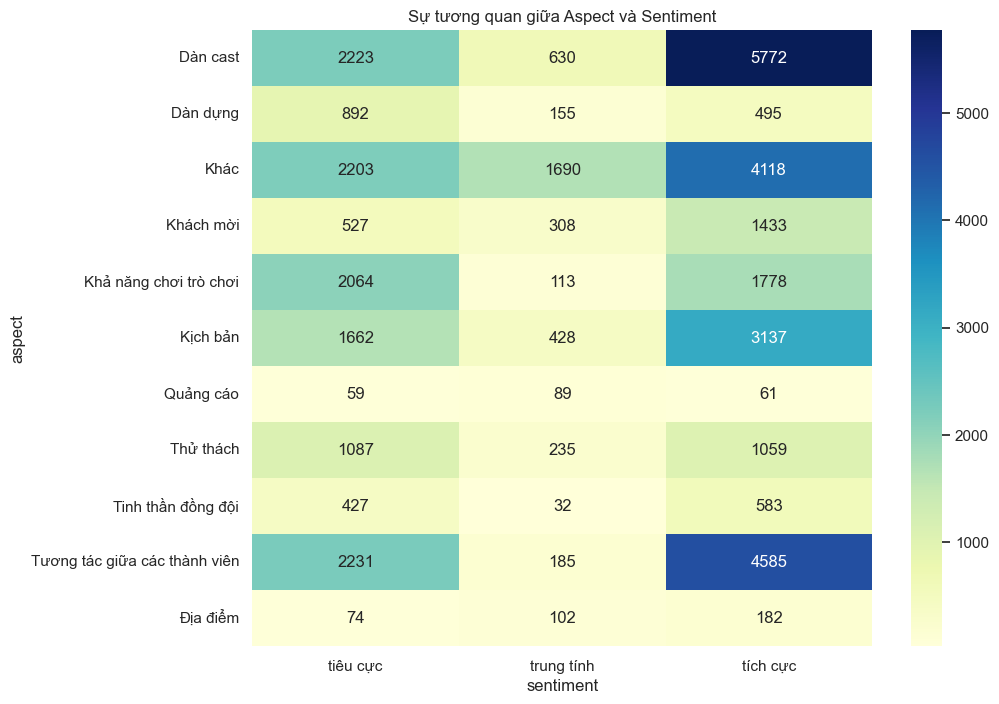

In [20]:
pivot_table = pd.crosstab(df['aspect'], df['sentiment'])

# Vẽ Heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(pivot_table, annot=True, cmap="YlGnBu", fmt='d')
plt.title('Sự tương quan giữa Aspect và Sentiment')
plt.show()

Chưa phân tích được giữa các Entity được nhắc đến

# Words Cloud

In [23]:
def clean_text(text):
    text = text.lower()
    text = re.sub(r'[^\w\s]', '', text) # Loại bỏ dấu câu
    return text

In [24]:
df['clean_text'] = df['text'].apply(clean_text)

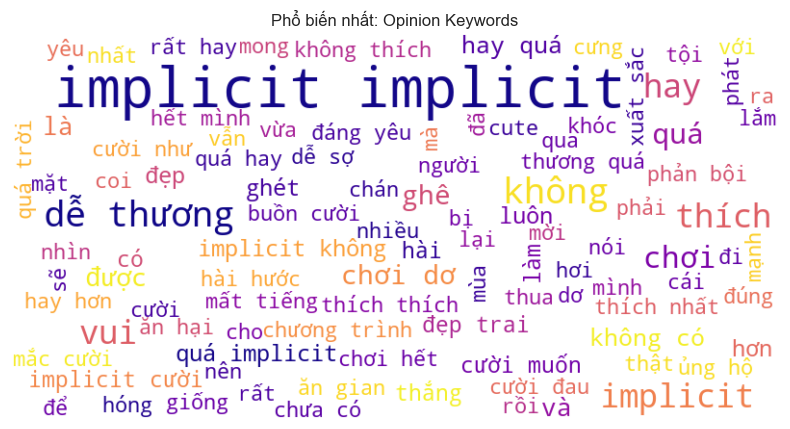

In [25]:
all_opinions = " ".join(df['opinion'].dropna().astype(str))

wordcloud = WordCloud(
    width=800, 
    height=400, 
    background_color='white',
    colormap='plasma',
    max_words=100
).generate(all_opinions)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Phổ biến nhất: Opinion Keywords")
plt.show()

## Loại bỏ các case không xác định rõ implicity

In [28]:
df['clean_text'] = df[df['clean_text'] != 'implicit']['clean_text']
df['opinion'] = df[df['opinion'] != 'implicit']['opinion']

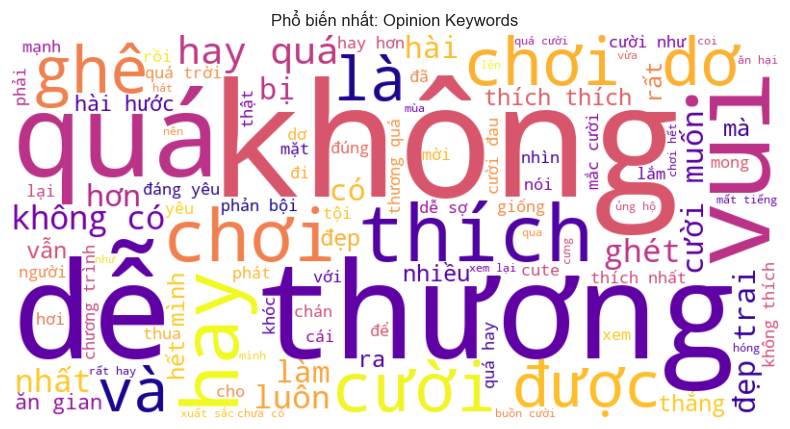

In [29]:
all_opinions = " ".join(df['opinion'].dropna().astype(str))

wordcloud = WordCloud(
    width=800, 
    height=400, 
    background_color='white',
    colormap='plasma',
    max_words=100
).generate(all_opinions)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title("Phổ biến nhất: Opinion Keywords")
plt.show()

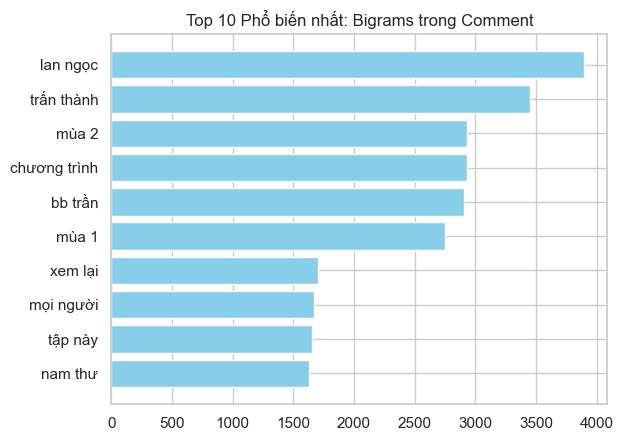

In [30]:
def get_top_ngrams(corpus, n=2, top_k=10):
    words = " ".join(corpus).split()
    n_grams = ngrams(words, n)
    n_gram_counts = Counter(n_grams)
    return n_gram_counts.most_common(top_k)

# Lấy Top 10 Bigrams (cụm 2 từ) phổ biến nhất trong cột Text
top_2grams = get_top_ngrams(df['clean_text'], n=2)

# Trực quan hóa bằng biểu đồ cột
words, counts = zip(*[(" ".join(g), c) for g, c in top_2grams])
plt.barh(words, counts, color='skyblue')
plt.gca().invert_yaxis()
plt.title("Top 10 Phổ biến nhất: Bigrams trong Comment")
plt.show()

In [31]:
# Lọc lấy các opinion mang sắc thái tích cực
pos_opinions = df[df['sentiment'] == 'tích cực']['opinion'].value_counts().head(10)
neg_opinions = df[df['sentiment'] == 'tiêu cực']['opinion'].value_counts().head(10)

print("Top 10 Lời khen:")
print(pos_opinions)

print("\nTop 10 Lời chê:")
print(neg_opinions)

Top 10 Lời khen:
opinion
thích         843
hay           383
dễ thương     372
hay quá       225
vui           204
thích nhất    178
yêu           134
đẹp trai      126
hóng          112
đẹp           108
Name: count, dtype: int64

Top 10 Lời chê:
opinion
ghét           294
chơi dơ        205
không thích    154
ăn gian        119
tội            100
dơ              78
chơi xấu        72
chán            71
không có        62
phản bội        62
Name: count, dtype: int64


In [32]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

label_counts = [len(item.get('labels', [])) for item in items]

# 2. Tạo DataFrame để phân tích
df_complexity = pd.DataFrame({'num_labels': label_counts})

# Thống kê mô tả
print(df_complexity['num_labels'].describe())
print(f"\nSố bộ bốn tối đa trong một câu: {df_complexity['num_labels'].max()}")

count    30149.000000
mean         1.443331
std          0.894057
min          0.000000
25%          1.000000
50%          1.000000
75%          2.000000
max         16.000000
Name: num_labels, dtype: float64

Số bộ bốn tối đa trong một câu: 16


Đa số các câu là nói về ít ít khía cạnh thôi